#### Specify some strange file locations

In [1]:
dosagefile = '/cbscratch/sbanerj/gtex_pca/gtex_v8_filtered.dosage.raw'
dosage_numpy_file = '/cbscratch/sbanerj/gtex_pca/gtex_dosage.npy'
eigensoft_file = '/cbscratch/sbanerj/gtex_pca/GTEX_v8_2020-02-21_WGS_838Indiv_Freeze_SHAPEIT2_phased_NoMissingGT_SNPfilter_MAF0.05_allchr_ldpruned.pca.evec'
expression_file = '/scratch/sbanerj/trans-eqtl/input/gtex_v8/expression/gtex_ms_raw_std_protein_coding_lncRNA.txt'

#### Setup environment

In [2]:
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from scipy import stats
import os
from scipy.cluster import hierarchy as hc

import matplotlib.pyplot as plt
import matplotlib
from mpl_toolkits.axes_grid1 import make_axes_locatable
import sys
sys.path.append('../')
from utils import mpl_stylesheet
mpl_stylesheet.banskt_presentation(fontfamily = 'latex-clearsans', fontsize = 18, colors = 'banskt', dpi = 300)

#### Load data

In [3]:
def read_gtex(filename): # returns N x G gene expression
    expr_list = list()
    donor_list = list()
    gene_list = list()
    with open(filename) as mfile:
        donor_list = mfile.readline().strip().split("\t")[1:]
        for line in mfile:
            linesplit = line.strip().split("\t")
            gene = linesplit[0].strip()
            gene_list.append(gene)
            expr = np.array([float(x) for x in linesplit[1:]])
            expr_list.append(expr)
    expr = np.transpose(np.array(expr_list))
    return expr, donor_list, gene_list

if not os.path.isfile(dosage_numpy_file):
    dosage = np.loadtxt(dosagefile, delimiter=' ', skiprows=1, usecols=range(6, 97612))
    np.save(dosage_numpy_file, dosage)
else:
    dosage = np.load(dosage_numpy_file)
gtsamples = list()
with open (dosagefile, 'r') as infile:
    next(infile)
    for line in infile:
        gtsamples.append(line.strip().split()[1])

gx, gxsamples, _ = read_gtex(expression_file)
sampleidx = [gtsamples.index(x) for x in gxsamples] # assumes all expression samples have genotype
dreduce = dosage[sampleidx, :]
gt = dreduce - np.mean(dreduce, axis = 0).reshape(1, -1)

print(f'{len(sampleidx)} samples, {gx.shape[1]} genes, {gt.shape[1]} SNPs.')
print(f'Centered and normalized genotype and expression. Samples in same order as `gxsamples`')

706 samples, 13236 genes, 97606 SNPs.
Centered and normalized genotype and expression. Samples in same order as `gxsamples`


#### Core functionality modules

Calculate PCA, distance matrix and KNN. 
Also need to map distance matrix from one sample space to another.  
Remove first N principal components from any matrix X

In [4]:
def get_pca(x, K):
    pca = PCA(n_components=K)
    pca.fit(x) # requires N x P (n_samples, n_features)
    x_pca = pca.transform(x)
    return x_pca

def get_distance(a, b):
    return np.linalg.norm(a - b)

def distance_matrix(x_pca):
    nsample = x_pca.shape[0]
    distance_matrix = np.zeros((nsample, nsample))
    for i in range(nsample):
        for j in range(i+1, nsample):
            dist = get_distance(x_pca[i,:], x_pca[j,:])
            distance_matrix[i, j] = dist
            distance_matrix[j, i] = dist
    return distance_matrix

def map_distance_matrix(dm, samples, target_samples):
    N = len(target_samples)
    newdm = np.zeros((N, N))
    newdm[:] = np.nan
    for i in range(N):
        if target_samples[i] in samples:
            newdm[i, i] = 0 # diagonal is always zero
            iold = samples.index(target_samples[i])
            for j in range(i+1, N):
                if target_samples[j] in samples:
                    jold = samples.index(target_samples[j])
                    newdm[i, j] = dm[iold, jold]
                    newdm[j, i] = dm[jold, iold]
    return newdm

def knn(gx, gt, dm, K):
    assert (gx.shape[0] == gt.shape[0])
    N = gx.shape[0]
    gx_knn = np.zeros_like(gx)
    gt_knn = np.zeros_like(gt)

    for i in range(N):
        #neighbors = np.argsort(distance_matrix[i, :kneighbor + 1])
        neighbors = np.argsort(dm[i, :])[:K + 1][1:]
        gx_knn[i, :] = gx[i, :] - np.mean(gx[neighbors, :], axis = 0)
        gt_knn[:, i] = gt[:, i] - np.mean(gt[:, neighbors[1:]], axis = 1)
        
    return gx_knn, gt_knn

def remove_nfirst_pcs(X, n=1):    
    mu = np.mean(X, axis = 0)
    Xnorm = X - mu
    U, S, Vt = np.linalg.svd(Xnorm, full_matrices=False)
    Xhat = U[:, n:] @ np.diag(S[n:]) @ Vt[n:, :] 
    Xhat += mu
    return Xhat

In [5]:
def plot_distance_matrices(dmA, dmB, norms = None):
    '''
    provide norms, if required, as norms = (norm1, norm2)
    where,
    norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
    norm2 = matplotlib.colors.DivergingNorm(vmin=0., vcenter=90., vmax=300.)
    '''
    
    fig = plt.figure(figsize = (12, 6))
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    
    # the zero distance between the same samples
    # is bad for the color scale.
    dmA[np.diag_indices(dmA.shape[0])] = np.nan
    dmB[np.diag_indices(dmB.shape[0])] = np.nan

    cmap1 = plt.get_cmap("YlOrRd")
    cmap1.set_bad('w')

    cmap2 = plt.get_cmap("YlGnBu")
    cmap2.set_bad('w')

    if norms is not None:
        norm1 = norms[0]
        norm2 = norms[1]
        im1 = ax1.imshow(dmA, cmap = cmap1, norm = norm1, interpolation='nearest')
        im2 = ax2.imshow(dmB, cmap = cmap2, norm = norm2, interpolation='nearest')
    else:
        im1 = ax1.imshow(dmA, cmap = cmap1, interpolation='nearest')
        im2 = ax2.imshow(dmB, cmap = cmap2, interpolation='nearest')        


    divider = make_axes_locatable(ax1)
    cax = divider.append_axes("right", size="5%", pad=0.2)
    cbar = plt.colorbar(im1, cax=cax, fraction = 0.1)

    divider = make_axes_locatable(ax2)
    cax = divider.append_axes("right", size="5%", pad=0.2)
    cbar = plt.colorbar(im2, cax=cax, fraction = 0.1)

    ax1.set_title("Genotype space", pad = 20)
    ax2.set_title("Expression space", pad = 20)
    
    plt.tight_layout()
    return fig

#### Calculate KNN and double KNN

In [6]:
# Before KNN
dm_gt = distance_matrix(get_pca(gt, 20))
dm_gx = distance_matrix(get_pca(gx, 30))

# Expression KNN
K = 30
gx_knn, gt_knn = knn(gx, gt, dm_gx, K)
dm_gt_knn = distance_matrix(get_pca(gt_knn, 40))
dm_gx_knn = distance_matrix(get_pca(gx_knn, gx_knn.shape[0]))

# Double KNN
K1 = 10
K2 = 30
gx_knn1, gt_knn1 = knn(gx, gt, dm_gt, K1)
dm_gx1 = distance_matrix(get_pca(gx_knn1, gx_knn1.shape[0]))
gx_knn2, gt_knn2 = knn(gx_knn1, gt_knn1, dm_gx1, K2)

dm_gt_knn2 = distance_matrix(get_pca(gt_knn2, 40))
dm_gx_knn2 = distance_matrix(get_pca(gx_knn2, gx_knn2.shape[0]))

# Option 1. Ordered in genotype space

In [7]:
o1 = hc.leaves_list(hc.linkage(dm_gt, method = 'centroid'))

/usr/users/sbanerj/miniconda3/envs/py36/lib/python3.7/site-packages/ipykernel_launcher.py:1: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  """Entry point for launching an IPython kernel.


In [8]:
norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=0., vcenter=75., vmax=300.)
norms = (norm1, norm2)

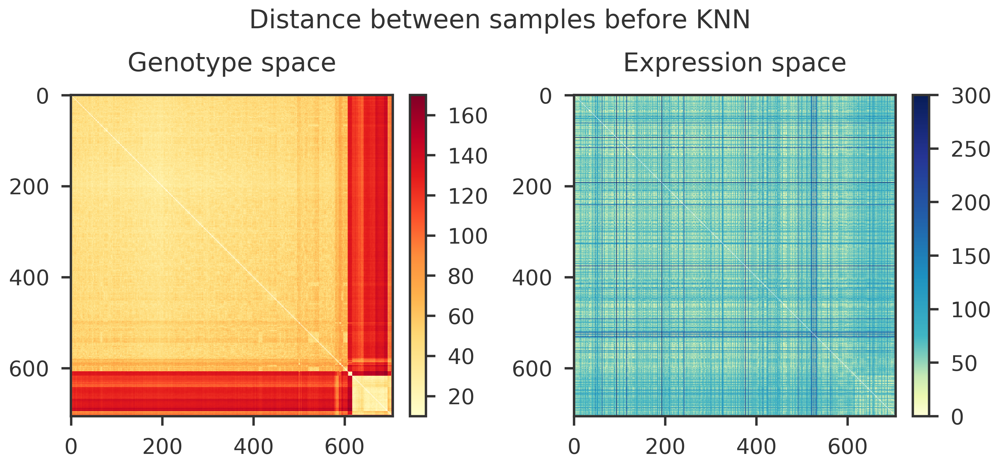

In [9]:
mgt = dm_gt[o1, :][:, o1]
mgx = dm_gx[o1, :][:, o1]
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Distance between samples before KNN")
plt.show()

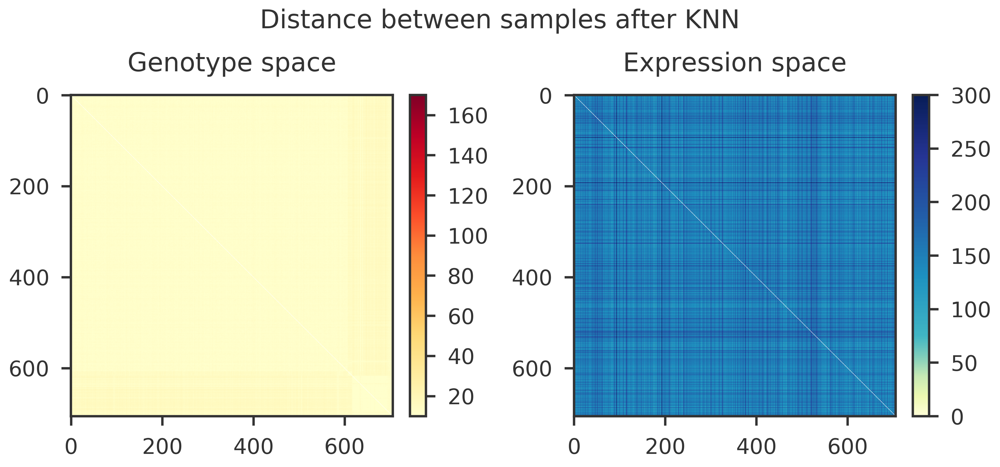

In [10]:
mgt = dm_gt_knn[o1, :][:, o1]
mgx = dm_gx_knn[o1, :][:, o1]
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Distance between samples after KNN")
plt.show()

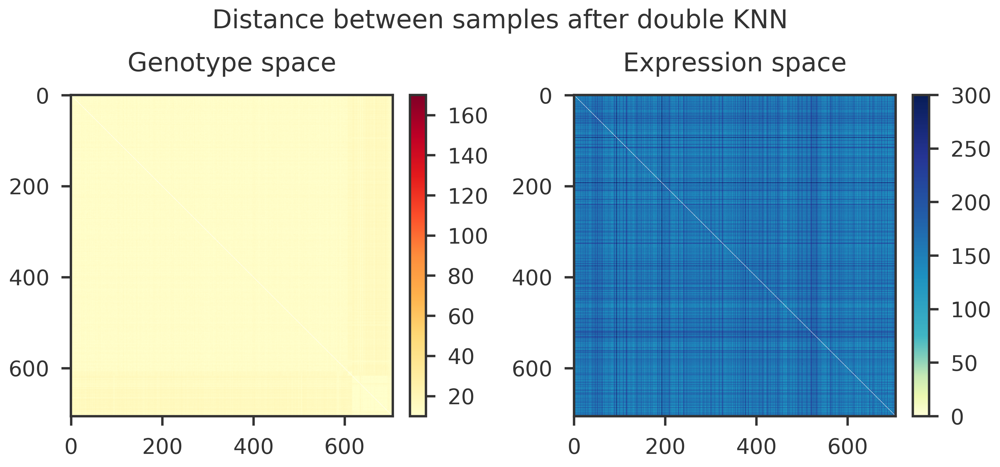

In [11]:
mgt = dm_gt_knn2[o1, :][:, o1]
mgx = dm_gx_knn2[o1, :][:, o1]
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Distance between samples after double KNN")
plt.show()

# Option 2. Ordered in expression space

In [12]:
o2 = hc.leaves_list(hc.linkage(dm_gx, method='centroid'))

/usr/users/sbanerj/miniconda3/envs/py36/lib/python3.7/site-packages/ipykernel_launcher.py:1: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  """Entry point for launching an IPython kernel.


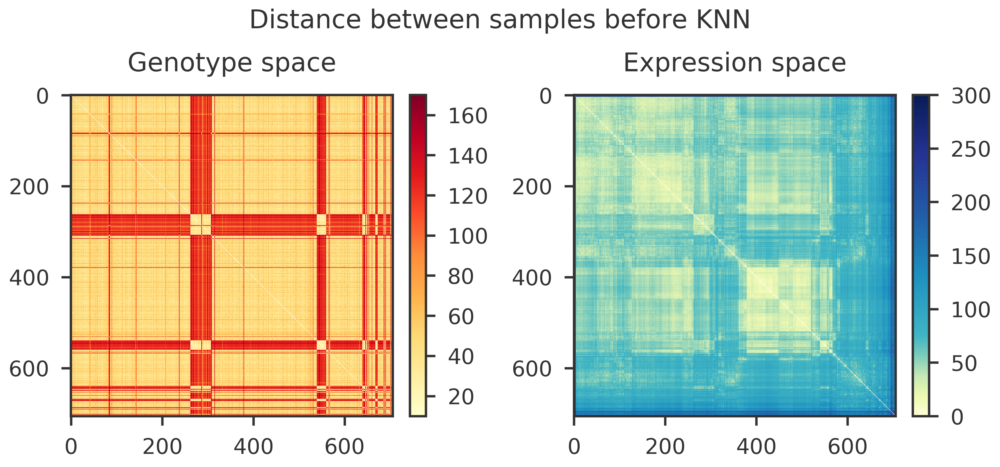

In [13]:
mgt = dm_gt[o2, :][:, o2]
mgx = dm_gx[o2, :][:, o2]
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Distance between samples before KNN")
plt.show()

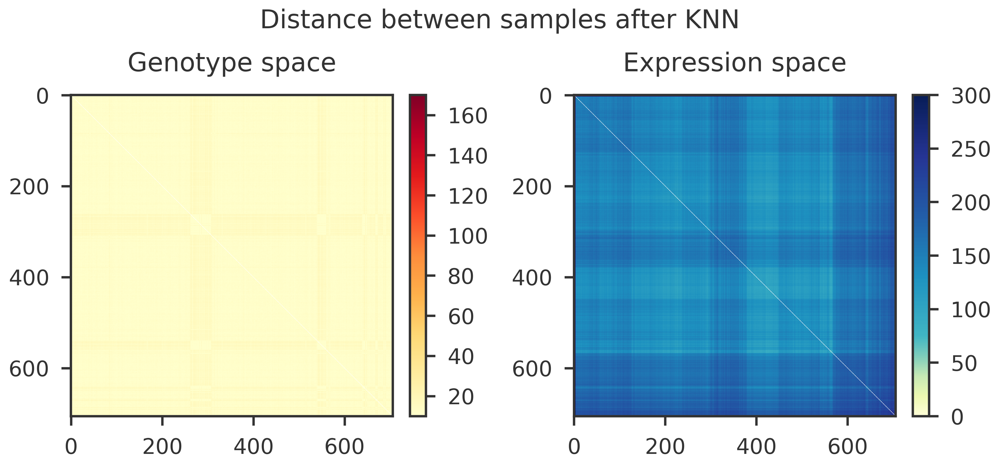

In [14]:
mgt = dm_gt_knn[o2, :][:, o2]
mgx = dm_gx_knn[o2, :][:, o2]
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Distance between samples after KNN")
plt.show()

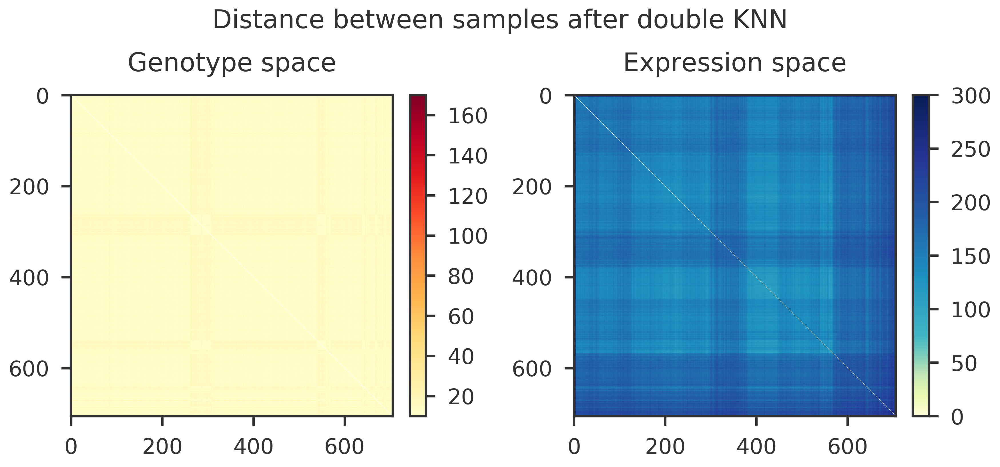

In [15]:
mgt = dm_gt_knn2[o2, :][:, o2]
mgx = dm_gx_knn2[o2, :][:, o2]
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Distance between samples after double KNN")
plt.show()

## Finally, let's look at the difference between KNN and double-KNN

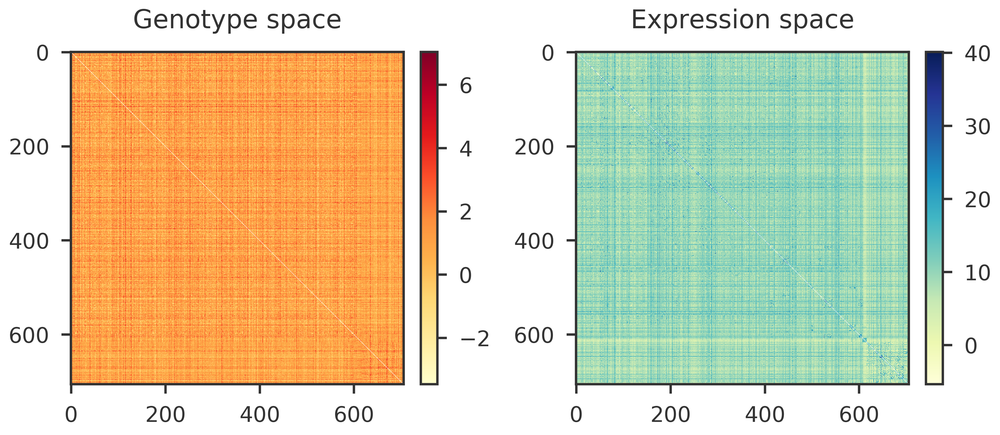

In [16]:
mgt = dm_gt_knn2[o1, :][:, o1] - dm_gt_knn[o1, :][:, o1]
mgx = dm_gx_knn2[o1, :][:, o1] - dm_gx_knn[o1, :][:, o1]
fig = plot_distance_matrices(mgt, mgx)
plt.show()

# Remove first PC from distance matrix before calculating neighbors.

### !! All variables are reassigned here !! 

In [17]:
# Before KNN
dm_gt = distance_matrix(get_pca(gt, 20))
dm_gx = distance_matrix(get_pca(gx, 30))
dm_gx_corr = remove_nfirst_pcs(dm_gx, n=2)

# Expression KNN
K = 30
gx_knn, gt_knn = knn(gx, gt, dm_gx_corr, K)
dm_gt_knn = distance_matrix(get_pca(gt_knn, 40))
dm_gx_knn = distance_matrix(get_pca(gx_knn, gx_knn.shape[0]))

# Double KNN
K1 = 10
K2 = 30
gx_knn1, gt_knn1 = knn(gx, gt, dm_gt, K1)
dm_gx1 = distance_matrix(get_pca(gx_knn1, gx_knn1.shape[0]))
dm_gx1_corr = remove_nfirst_pcs(dm_gx1, n=2)
gx_knn2, gt_knn2 = knn(gx_knn1, gt_knn1, dm_gx1_corr, K2)

dm_gt_knn2 = distance_matrix(get_pca(gt_knn2, 40))
dm_gx_knn2 = distance_matrix(get_pca(gx_knn2, gx_knn2.shape[0]))

#### Using Option 2: Ordered in expression space.
Now ordering in expression space and genotype space are similar. 
Probably, we removed other covariates, and population substructure becomes the most important confounder.

In [18]:
o2 = hc.leaves_list(hc.linkage(dm_gx_corr, method = 'centroid'))

In [19]:
norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=0., vcenter=80., vmax=300.)
norms = (norm1, norm2)

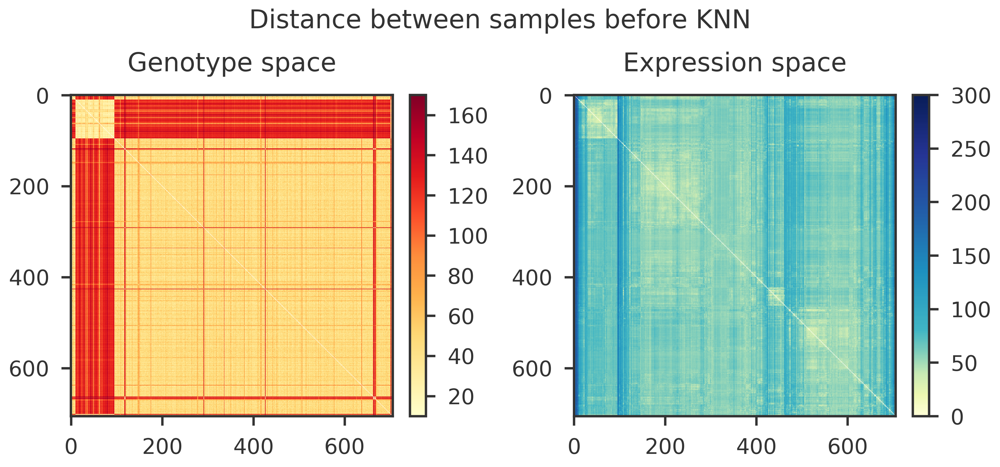

In [20]:
mgt = dm_gt[o2, :][:, o2]
mgx = dm_gx_corr[o2, :][:, o2]
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Distance between samples before KNN")
plt.show()

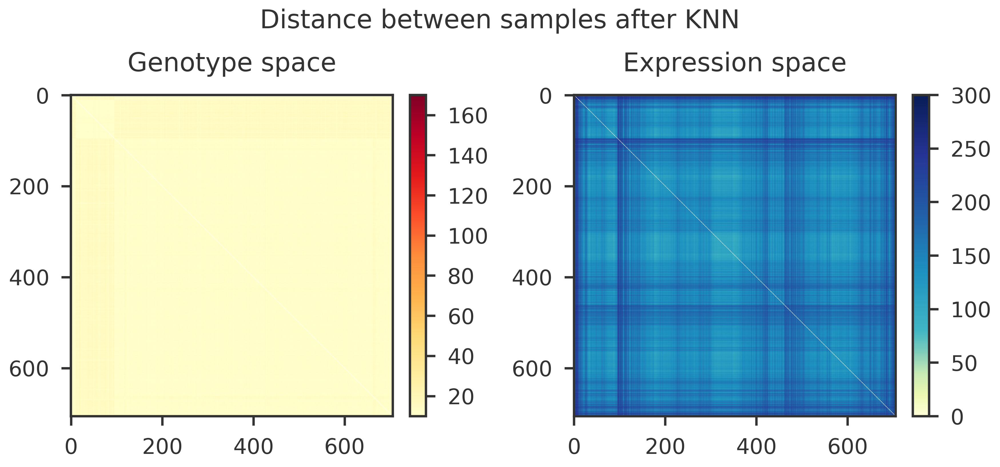

In [21]:
mgt = dm_gt_knn[o2, :][:, o2]
mgx = dm_gx_knn[o2, :][:, o2]
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Distance between samples after KNN")
plt.show()

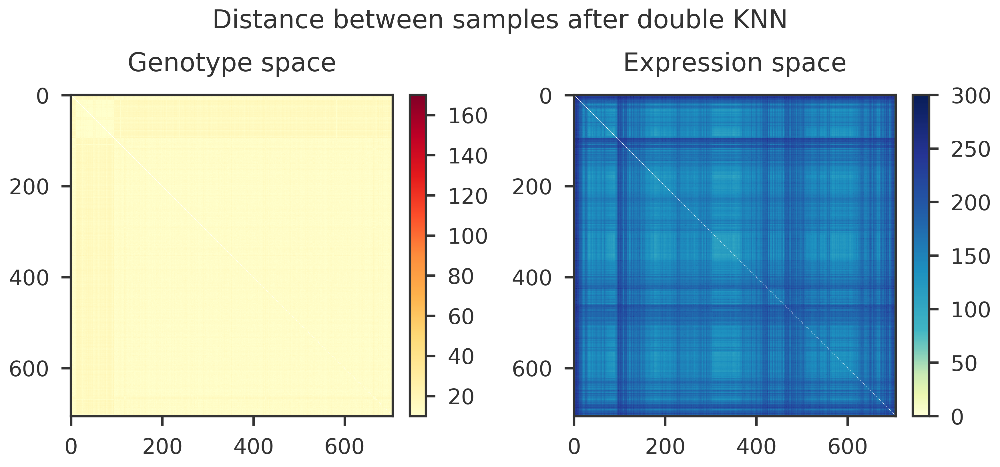

In [22]:
mgt = dm_gt_knn2[o2, :][:, o2]
mgx = dm_gx_knn2[o2, :][:, o2]
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Distance between samples after double KNN")
plt.show()